In [39]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import numpy as np
import numpy as np
sc.set_figure_params(dpi=100, dpi_save=300, frameon=False, )
import shutup; shutup.please()
import anndata as ad

In [3]:
from scarches.models.scpoli import scPoli

/home/aih/shrey.parikh/miniconda3/envs/scarches/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
 captum (see https://github.com/pytorch/captum).


In [4]:
adata = sc.read_h5ad(('/home/aih/shrey.parikh/PDAC/PDAC/Classifier/scpoli_int_donor_final.h5ad'))

In [34]:
ref = sc.read_h5ad('../../concatenated_datasets/PDAC_concat_hvg_batch_key_samples_hvg.h5ad')

In [5]:
scpoli_ref = scPoli.load("/home/aih/shrey.parikh/PDAC/PDAC/scPoli/scPoli_model_donor_label_transfer",)

/home/aih/shrey.parikh/miniconda3/envs/scarches/lib/python3.9/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 253805 × 3781
    obs: 'Dataset', 'ID', 'pseudo_barcode', 'Level 1 Annotation', 'Level 2 Annotation', 'Level 3 Annotation', 'Cell_type', 'scanvi_labels', 'Label_Harmonized', 'conditions_combined'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'hvg', 'log1p', 'neighbors', 'umap'
    obsm: 'X_cnv', 'X_cnv_pca', 'X_cnv_umap', 'X_harmony', 'X_pca', 'X_umap'
    layers: 'counts', 'raw'
    obsp: 'connectivities', 'distances'
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [5]
Encoder Architecture:
	Input Layer in, out and cond: 3781 62 5
	Mean/Var Layer in/out: 62 10
Decoder Architecture:
	First Layer in, out and cond:  10 62 5
	Output Layer in/out:  62 3781 



In [6]:
scpoli = scPoli.load("/home/aih/shrey.parikh/PDAC/PDAC/scPoli/scPoli_model_donor_label_transfer_query")

/home/aih/shrey.parikh/miniconda3/envs/scarches/lib/python3.9/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/home/aih/shrey.parikh/miniconda3/envs/scarches/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 584178 × 3781
    obs: 'Dataset', 'ID', 'pseudo_barcode', 'Level 1 Annotation', 'Level 2 Annotation', 'Level 3 Annotation', 'Cell_type', 'scanvi_labels', 'Label_Harmonized', 'conditions_combined'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'hvg', 'log1p', 'neighbors', 'umap'
    obsm: 'X_cnv', 'X_cnv_pca', 'X_cnv_umap', 'X_harmony', 'X_pca', 'X_umap'
    layers: 'counts', 'raw'
    obsp: 'connectivities', 'distances'
Embedding dictionary:
 	Num conditions: [11]
 	Embedding dim: [5]
Encoder Architecture:
	Input Layer in, out and cond: 3781 62 5
	Mean/Var Layer in/out: 62 10
Decoder Architecture:
	First Layer in, out and cond:  10 62 5
	Output Layer in/out:  62 3781 



In [15]:
scpoli_latent = scpoli.get_latent(scpoli.adata)

In [16]:
scpoli_ref_latent = scpoli_ref.get_latent(scpoli_ref.adata)

In [19]:
scpoli_ref_latent.shape

(253805, 10)

In [25]:
scpoli_ref.adata.obs_names = scpoli_ref.adata.obs.pseudo_barcode 

In [29]:
scpoli.adata.obs_names = scpoli.adata.obs.pseudo_barcode 

In [9]:
adata.obsm['X_emb_correct'] = np.zeros((adata.n_obs, 10))  # or np.full((adata.n_obs, n_latent), np.nan)

In [10]:
adata.obsm['X_emb_correct'].shape

(837983, 10)

In [26]:
adata.obs_names = adata.obs.pseudo_barcode

In [28]:
# Map the new embeddings back to the original adata using indices
source_indices = adata.obs_names.isin(scpoli_ref.adata.obs_names)
adata.obsm['X_emb_correct'][source_indices, :] = scpoli_ref_latent  # Assuming data_latent_source is the embedding of source_adata

In [37]:
target_indices = adata.obs_names.isin(scpoli.adata.obs_names)
adata.obsm['X_emb_correct'][target_indices, :] = scpoli_latent

In [4]:
adata_labeled = adata[adata.obs.Dataset.isin(datasets)]
adata_unlabeled = adata[~adata.obs.Dataset.isin(datasets)]
                                             

In [35]:
ref.obs

,Dataset,ID,pseudo_barcode,Level 1 Annotation,Level 2 Annotation,Level 3 Annotation,Cell_type,scanvi_labels,Label_Harmonized
AAACCCAAGTCATCGT-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_1,NaN,NaN,NaN,NaN,Myeloid Cell,Unknown
AAACCCACAACCACGC-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_2,NaN,NaN,NaN,NaN,CAF,Unknown
AAACCCACAACTCCCT-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_3,NaN,NaN,NaN,NaN,T Cell,Unknown
AAACCCACAGACAATA-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_4,NaN,NaN,NaN,NaN,T Cell,Unknown
AAACCCACATGCCGAC-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_5,NaN,NaN,NaN,NaN,T Cell,Unknown
...,...,...,...,...,...,...,...,...,...
pk210318_TTTGGTTTCCGATCTC-1,Zenodo_OUGS,pk210318,annotated_cell_253801,NaN,NaN,NaN,Macrophage cell,Macrophage,Macrophage
pk210318_TTTGGTTTCCTTCACG-1,Zenodo_OUGS,pk210318,annotated_cell_253802,NaN,NaN,NaN,Macrophage cell,Macrophage,Macrophage
pk210318_TTTGTTGCAATGCAAA-1,Zenodo_OUGS,pk210318,annotated_cell_253803,NaN,NaN,NaN,T cell,T Cell,T Cell
pk210318_TTTGTTGGTATGAGCG-1,Zenodo_OUGS,pk210318,annotated_cell_253804,NaN,NaN,NaN,T cell,T Cell,T Cell


In [31]:
adata.obs

,Dataset,ID,pseudo_barcode,scanvi_labels,Label_Harmonized,conditions_combined,cell_type_pred,cell_type_uncert,Label_Harmonized_pred,Label_Harmonized_uncert,...,Cell_type_Schlesinger,Malignant Classification_Schlesinger,cell_types_Ding,Label_Harmonized_Ding,Malignant_Classification_Regev,Malignant_Classification_Ding,Malignant_Classification,Label_Harmonized_Merged,Predicted_Malignant_Classification,Predicted_MC_Probability
pseudo_barcode,,,,,,,,,,,,,,,,,,,,,
annotated_cell_1,Regev,T25,annotated_cell_1,Endothelial Cell,Endothelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Endothelial Cell,Non-Malignant,0.001688
annotated_cell_2,Regev,T25,annotated_cell_2,Epithelial Cell,Epithelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Epithelial Cell,Non-Malignant,0.006803
annotated_cell_3,Regev,T25,annotated_cell_3,Endothelial Cell,Endothelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Endothelial Cell,Non-Malignant,0.006047
annotated_cell_4,Regev,T25,annotated_cell_4,Malignant Epithelial Cell,Malignant Epithelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Malignant,nan,Malignant,Malignant Epithelial Cell,Malignant,0.977772
annotated_cell_5,Regev,T25,annotated_cell_5,CAF,CAF,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,CAF,Non-Malignant,0.004095
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
non_annotated_cell_568545,Zhang,GSM5910784_Case1-YF_PDAC,non_annotated_cell_568545,Malignant Epithelial Cell,Unknown,Zhang,Ductal Cell,0.32598310708999634,nan,nan,...,nan,nan,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,0.441065
non_annotated_cell_568546,Zhang,GSM5910784_Case1-YF_PDAC,non_annotated_cell_568546,Malignant Epithelial Cell,Unknown,Zhang,Ductal Cell,0.22000081837177277,nan,nan,...,nan,nan,nan,nan,nan,nan,Non-Malignant,nan,Malignant,0.633027
non_annotated_cell_568547,Zhang,GSM5910784_Case1-YF_PDAC,non_annotated_cell_568547,Malignant Epithelial Cell,Unknown,Zhang,Malignant Epithelial Cell,0.5913703441619873,nan,nan,...,nan,nan,nan,nan,nan,nan,Non-Malignant,nan,Malignant,0.986708


In [3]:
datasets = ['Regev', 'Moncada', 'Schlesinger', 'Zenodo_OUGS', 'Ding', 'Peng']

In [9]:
adata_rearranged = ad.concat([adata_labeled, adata_unlabeled])

In [3]:
pdac_markers = {
    "Malignant Ductal Cells": {
        "CK19": "Cytokeratin 19, typical for ductal cells, used to identify malignant transformation.",
        "MUC1": "Mucin 1, overexpressed in many adenocarcinomas, distinguishes malignant cells from benign.",
        "CA19-9": "Carbohydrate Antigen 19-9, often used as a serum biomarker, also indicates malignancy in tumor cells.",
        "CK17": "Cytokeratin 17, often associated with poor prognosis and more aggressive forms of cancer."
    },
    "Malignant Epithelial Cells": {
        "EpCAM": "Epithelial Cellular Adhesion Molecule, expressed on epithelial tumor cells, used for detecting epithelial-derived tumors.",
        "CK7": "Cytokeratin 7, frequently expressed alongside CK19 in epithelial cells of PDAC.",
        "EGFR": "Epidermal Growth Factor Receptor, overexpressed in malignant epithelial cells, associated with tumor growth.",
        "E-Cadherin": "Calcium-dependent adhesion protein, loss is associated with metastasis and poor prognosis."
    },
    "ADM Cells": {
        "SOX9": "SOX9, a transcription factor involved in the acinar-to-ductal metaplasia, key in early PDAC development.",
        "HPA1": "Hepatocyte Nuclear Factor 1 Homeobox A, alteration leads to acinar to ductal metaplasia.",
        "KLF4": "Kruppel Like Factor 4, implicated in the reprogramming of acinar cells to ductal-like structures during ADM.",
        "PDX1": "Pancreatic and duodenal homeobox 1, plays a crucial role in pancreatic development and metaplastic changes."
    }
}


In [11]:
cell_type_markers = {
    'Myeloid Cell': ['CD14', 'CD11b', 'CD68'],
    'Epithelial Cell': ['EPCAM', 'KRT19', 'CDH1'],
    'CAF (Cancer-Associated Fibroblast)': ['FAP', 'ACTA2', 'PDGFRB'],
    'Ductal Cell': ['KRT7', 'SOX9', 'KRT19'],
    'Malignant Epithelial Cell': ['TP53', 'SMAD4', 'KRAS', 'CDKN2A', 'NOTCH1'],
    'Pericyte': ['PDGFRB', 'RGS5', 'CD146'],
    'Smooth Muscle Cell': ['ACTA2', 'MYH11', 'TAGLN'],
    'T Cell': ['CD3D', 'CD3E', 'CD8A'],  # For CD8 T cells, or use 'CD4' for helper T cells
    'Endothelial Cell': ['PECAM1', 'VWF', 'CDH5'],
    'Endocrine Cell': ['CHGA', 'SYP', 'INS', 'GCG', 'SST'],  # 'INS' for insulin (beta cells)
    'B cell': ['CD19', 'CD20', 'MS4A1']
}

In [5]:
pdac_gene_markers = {
    "Malignant Ductal Cells": ["KRT19", "MUC1", "CA19-9", "KRT17"],
    "Malignant Epithelial Cells": ["EPCAM", "KRT7", "EGFR", "CDH1", 'TP53', 'SMAD4', 'KRAS', 'CDKN2A', 'NOTCH1'],
    "ADM Cells": ["SOX9", "HNF1A", "KLF4", "PDX1"]
}


In [3]:
ref = sc.read_h5ad('/home/aih/shrey.parikh/PDAC/PDAC/concatenated_datasets/PDAC_concat_hvg_batch_key_samples_hvg.h5ad')

In [28]:
obs = adata.obs.copy()

In [29]:
adata.obs = ref.obs

In [45]:
obs.index = obs.pseudo_barcode

In [46]:
adata.obs_names = adata.obs.pseudo_barcode

In [47]:
adata.obs

,Dataset,ID,pseudo_barcode,Level 1 Annotation,Level 2 Annotation,Level 3 Annotation,Cell_type,scanvi_labels,Label_Harmonized
pseudo_barcode,,,,,,,,,
non_annotated_cell_1,Ding,HT056P1,non_annotated_cell_1,NaN,NaN,NaN,NaN,Myeloid Cell,Unknown
non_annotated_cell_2,Ding,HT056P1,non_annotated_cell_2,NaN,NaN,NaN,NaN,CAF,Unknown
non_annotated_cell_3,Ding,HT056P1,non_annotated_cell_3,NaN,NaN,NaN,NaN,T Cell,Unknown
non_annotated_cell_4,Ding,HT056P1,non_annotated_cell_4,NaN,NaN,NaN,NaN,T Cell,Unknown
non_annotated_cell_5,Ding,HT056P1,non_annotated_cell_5,NaN,NaN,NaN,NaN,T Cell,Unknown
...,...,...,...,...,...,...,...,...,...
annotated_cell_253801,Zenodo_OUGS,pk210318,annotated_cell_253801,NaN,NaN,NaN,Macrophage cell,Macrophage,Macrophage
annotated_cell_253802,Zenodo_OUGS,pk210318,annotated_cell_253802,NaN,NaN,NaN,Macrophage cell,Macrophage,Macrophage
annotated_cell_253803,Zenodo_OUGS,pk210318,annotated_cell_253803,NaN,NaN,NaN,T cell,T Cell,T Cell


In [51]:
adata.obs_names = adata.obs_names.astype(str)

In [52]:
adata.obs_names_make_unique()

In [55]:
obs

,Dataset,ID,pseudo_barcode,scanvi_labels,Label_Harmonized,conditions_combined,cell_type_pred,cell_type_uncert,Label_Harmonized_pred,Label_Harmonized_uncert,...,Cell_type_Schlesinger,Malignant Classification_Schlesinger,cell_types_Ding,Label_Harmonized_Ding,Malignant_Classification_Regev,Malignant_Classification_Ding,Malignant_Classification,Label_Harmonized_Merged,Predicted_Malignant_Classification,Predicted_MC_Probability
pseudo_barcode,,,,,,,,,,,,,,,,,,,,,
annotated_cell_1,Regev,T25,annotated_cell_1,Endothelial Cell,Endothelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Endothelial Cell,Non-Malignant,0.001688
annotated_cell_2,Regev,T25,annotated_cell_2,Epithelial Cell,Epithelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Epithelial Cell,Non-Malignant,0.006803
annotated_cell_3,Regev,T25,annotated_cell_3,Endothelial Cell,Endothelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Endothelial Cell,Non-Malignant,0.006047
annotated_cell_4,Regev,T25,annotated_cell_4,Malignant Epithelial Cell,Malignant Epithelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Malignant,nan,Malignant,Malignant Epithelial Cell,Malignant,0.977772
annotated_cell_5,Regev,T25,annotated_cell_5,CAF,CAF,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,CAF,Non-Malignant,0.004095
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
non_annotated_cell_568545,Zhang,GSM5910784_Case1-YF_PDAC,non_annotated_cell_568545,Malignant Epithelial Cell,Unknown,Zhang,Ductal Cell,0.32598310708999634,nan,nan,...,nan,nan,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,0.441065
non_annotated_cell_568546,Zhang,GSM5910784_Case1-YF_PDAC,non_annotated_cell_568546,Malignant Epithelial Cell,Unknown,Zhang,Ductal Cell,0.22000081837177277,nan,nan,...,nan,nan,nan,nan,nan,nan,Non-Malignant,nan,Malignant,0.633027
non_annotated_cell_568547,Zhang,GSM5910784_Case1-YF_PDAC,non_annotated_cell_568547,Malignant Epithelial Cell,Unknown,Zhang,Malignant Epithelial Cell,0.5913703441619873,nan,nan,...,nan,nan,nan,nan,nan,nan,Non-Malignant,nan,Malignant,0.986708


In [56]:
adata = adata[obs.index]

In [34]:
common_ids = ref.obs.pseudo_barcode.isin(adata.obs.pseudo_barcode)

In [38]:
ref.obs

,Dataset,ID,pseudo_barcode,Level 1 Annotation,Level 2 Annotation,Level 3 Annotation,Cell_type,scanvi_labels,Label_Harmonized
AAACCCAAGTCATCGT-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_1,NaN,NaN,NaN,NaN,Myeloid Cell,Unknown
AAACCCACAACCACGC-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_2,NaN,NaN,NaN,NaN,CAF,Unknown
AAACCCACAACTCCCT-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_3,NaN,NaN,NaN,NaN,T Cell,Unknown
AAACCCACAGACAATA-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_4,NaN,NaN,NaN,NaN,T Cell,Unknown
AAACCCACATGCCGAC-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_5,NaN,NaN,NaN,NaN,T Cell,Unknown
...,...,...,...,...,...,...,...,...,...
pk210318_TTTGGTTTCCGATCTC-1,Zenodo_OUGS,pk210318,annotated_cell_253801,NaN,NaN,NaN,Macrophage cell,Macrophage,Macrophage
pk210318_TTTGGTTTCCTTCACG-1,Zenodo_OUGS,pk210318,annotated_cell_253802,NaN,NaN,NaN,Macrophage cell,Macrophage,Macrophage
pk210318_TTTGTTGCAATGCAAA-1,Zenodo_OUGS,pk210318,annotated_cell_253803,NaN,NaN,NaN,T cell,T Cell,T Cell
pk210318_TTTGTTGGTATGAGCG-1,Zenodo_OUGS,pk210318,annotated_cell_253804,NaN,NaN,NaN,T cell,T Cell,T Cell


In [36]:
adata.obs

,Dataset,ID,pseudo_barcode,Level 1 Annotation,Level 2 Annotation,Level 3 Annotation,Cell_type,scanvi_labels,Label_Harmonized
AAACCCAAGTCATCGT-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_1,NaN,NaN,NaN,NaN,Myeloid Cell,Unknown
AAACCCACAACCACGC-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_2,NaN,NaN,NaN,NaN,CAF,Unknown
AAACCCACAACTCCCT-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_3,NaN,NaN,NaN,NaN,T Cell,Unknown
AAACCCACAGACAATA-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_4,NaN,NaN,NaN,NaN,T Cell,Unknown
AAACCCACATGCCGAC-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_5,NaN,NaN,NaN,NaN,T Cell,Unknown
...,...,...,...,...,...,...,...,...,...
pk210318_TTTGGTTTCCGATCTC-1,Zenodo_OUGS,pk210318,annotated_cell_253801,NaN,NaN,NaN,Macrophage cell,Macrophage,Macrophage
pk210318_TTTGGTTTCCTTCACG-1,Zenodo_OUGS,pk210318,annotated_cell_253802,NaN,NaN,NaN,Macrophage cell,Macrophage,Macrophage
pk210318_TTTGTTGCAATGCAAA-1,Zenodo_OUGS,pk210318,annotated_cell_253803,NaN,NaN,NaN,T cell,T Cell,T Cell
pk210318_TTTGTTGGTATGAGCG-1,Zenodo_OUGS,pk210318,annotated_cell_253804,NaN,NaN,NaN,T cell,T Cell,T Cell


In [35]:
ref_filtered = ref[common_ids].copy()

AAACCCAAGTCATCGT-1-HT056P-S1PAA1-0-0-0    True
AAACCCACAACCACGC-1-HT056P-S1PAA1-0-0-0    True
AAACCCACAACTCCCT-1-HT056P-S1PAA1-0-0-0    True
AAACCCACAGACAATA-1-HT056P-S1PAA1-0-0-0    True
AAACCCACATGCCGAC-1-HT056P-S1PAA1-0-0-0    True
                                          ... 
pk210318_TTTGGTTTCCGATCTC-1               True
pk210318_TTTGGTTTCCTTCACG-1               True
pk210318_TTTGTTGCAATGCAAA-1               True
pk210318_TTTGTTGGTATGAGCG-1               True
pk210318_TTTGTTGTCCGTATGA-1               True
Name: pseudo_barcode, Length: 837983, dtype: bool

In [60]:
obs.

,Dataset,ID,pseudo_barcode,scanvi_labels,Label_Harmonized,conditions_combined,cell_type_pred,cell_type_uncert,Label_Harmonized_pred,Label_Harmonized_uncert,...,Cell_type_Schlesinger,Malignant Classification_Schlesinger,cell_types_Ding,Label_Harmonized_Ding,Malignant_Classification_Regev,Malignant_Classification_Ding,Malignant_Classification,Label_Harmonized_Merged,Predicted_Malignant_Classification,Predicted_MC_Probability
pseudo_barcode,,,,,,,,,,,,,,,,,,,,,
annotated_cell_1,Regev,T25,annotated_cell_1,Endothelial Cell,Endothelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Endothelial Cell,Non-Malignant,0.001688
annotated_cell_2,Regev,T25,annotated_cell_2,Epithelial Cell,Epithelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Epithelial Cell,Non-Malignant,0.006803
annotated_cell_3,Regev,T25,annotated_cell_3,Endothelial Cell,Endothelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Endothelial Cell,Non-Malignant,0.006047
annotated_cell_4,Regev,T25,annotated_cell_4,Malignant Epithelial Cell,Malignant Epithelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Malignant,nan,Malignant,Malignant Epithelial Cell,Malignant,0.977772
annotated_cell_5,Regev,T25,annotated_cell_5,CAF,CAF,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,CAF,Non-Malignant,0.004095
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
non_annotated_cell_568545,Zhang,GSM5910784_Case1-YF_PDAC,non_annotated_cell_568545,Malignant Epithelial Cell,Unknown,Zhang,Ductal Cell,0.32598310708999634,nan,nan,...,nan,nan,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,0.441065
non_annotated_cell_568546,Zhang,GSM5910784_Case1-YF_PDAC,non_annotated_cell_568546,Malignant Epithelial Cell,Unknown,Zhang,Ductal Cell,0.22000081837177277,nan,nan,...,nan,nan,nan,nan,nan,nan,Non-Malignant,nan,Malignant,0.633027
non_annotated_cell_568547,Zhang,GSM5910784_Case1-YF_PDAC,non_annotated_cell_568547,Malignant Epithelial Cell,Unknown,Zhang,Malignant Epithelial Cell,0.5913703441619873,nan,nan,...,nan,nan,nan,nan,nan,nan,Non-Malignant,nan,Malignant,0.986708


In [61]:
adata.obs_names_make_unique()

: 

: 

In [ ]:
adata.osb['scpoli_labels'] = adata.obs.pseudo_barcode.map(obs.scpoli_labels)

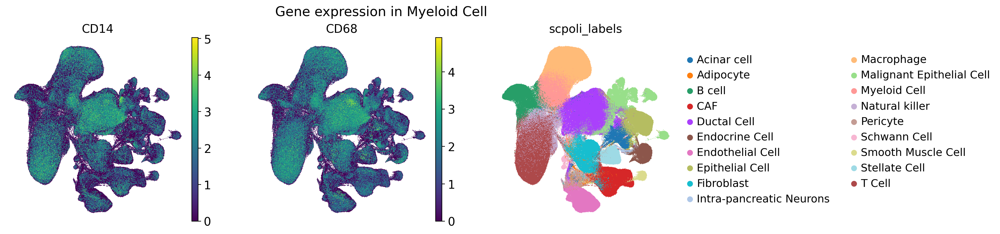

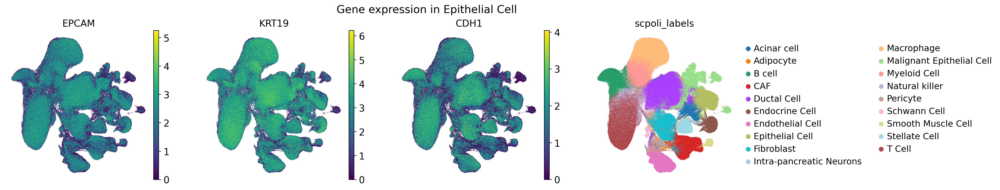

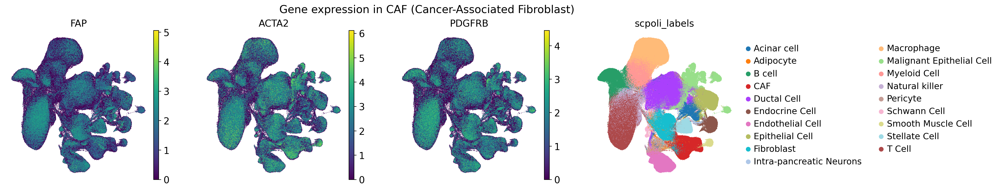

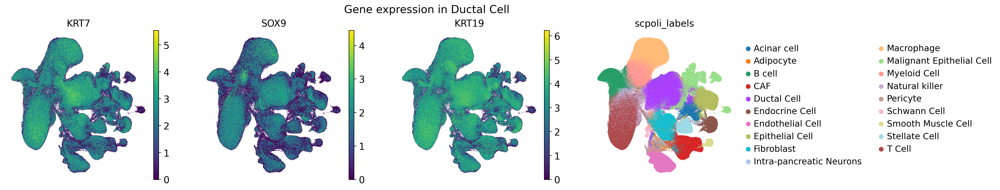

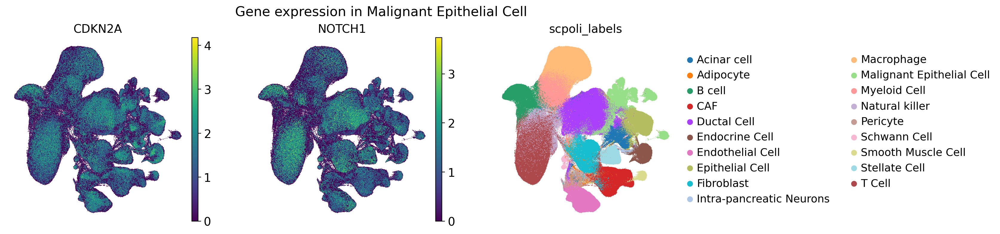

...

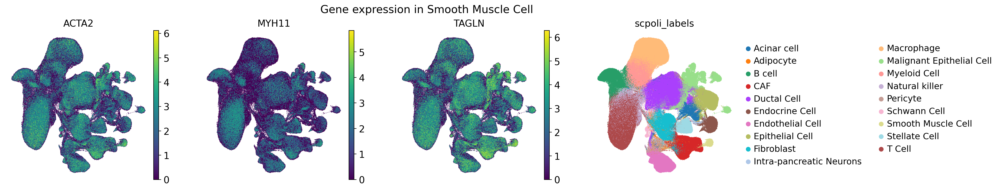

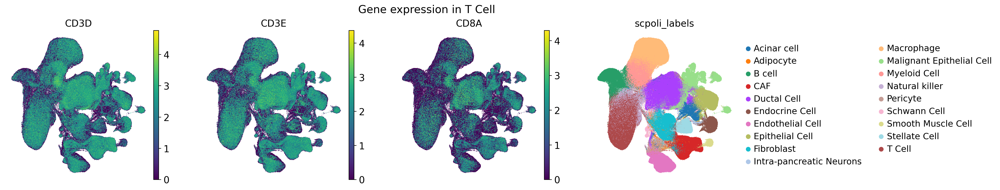

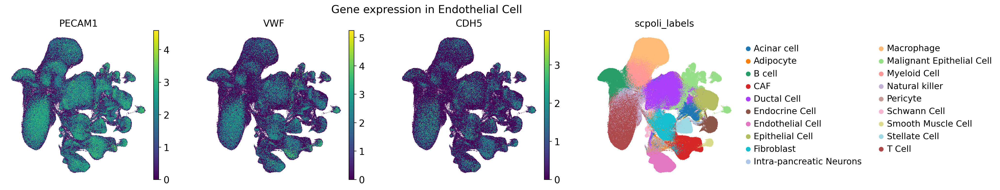

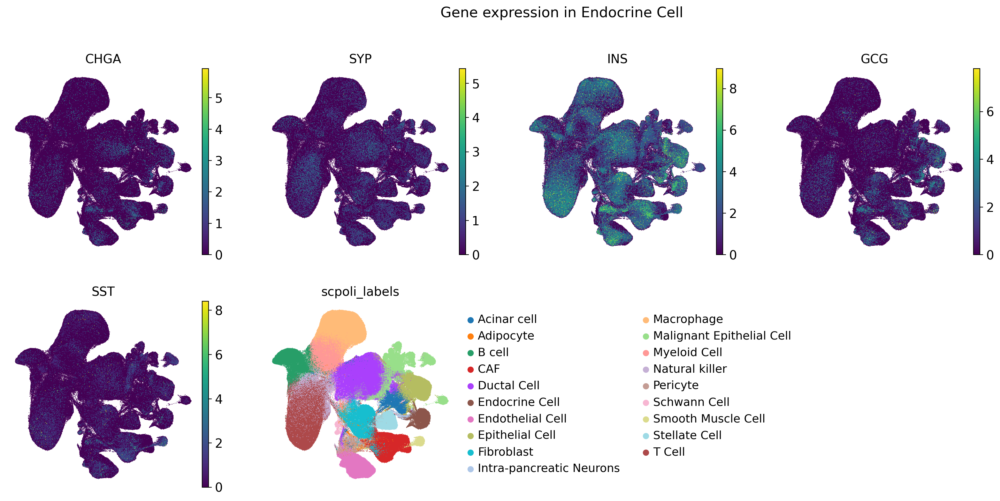

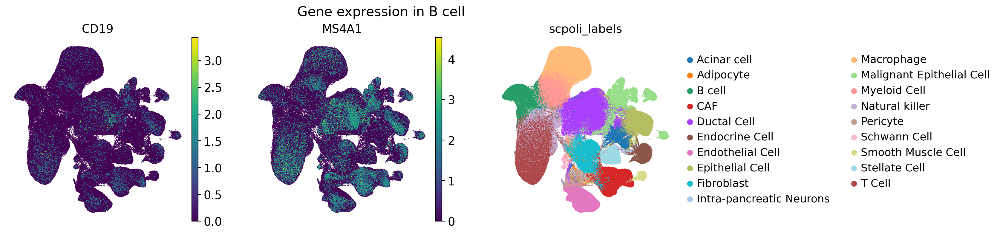

In [31]:
for cell, genes in cell_type_markers.items():
    # Modify the plotting to only include genes that are present in the 'var' DataFrame
    genes_to_plot = [gene for gene in genes if gene in adata.var_names]
    genes_to_plot.append('scpoli_labels')  # Add 'predictions' to the list for coloring

    if genes_to_plot:
        # Create a UMAP plot for each gene
        axs = sc.pl.umap(adata_rearranged, color=genes_to_plot, show=False, frameon=False, size=2)

        # Set the title for the entire figure to be in the centre
        plt.suptitle(f'Gene expression in {cell}', va='bottom', ha='center', fontsize=16)
        plt.show()

In [27]:
ref.obs

,Dataset,ID,pseudo_barcode,Level 1 Annotation,Level 2 Annotation,Level 3 Annotation,Cell_type,scanvi_labels,Label_Harmonized
TACGCTCTCACGGACC-1,Simeone,GSM6204127_P19,non_annotated_cell_342202,NaN,NaN,NaN,NaN,T Cell,Unknown
GTCGTAAGTTACCTTT-1-HT200P1-XBc2_1-1,Ding,HT200P1,non_annotated_cell_143667,NaN,NaN,NaN,NaN,B cell,Unknown
GTCGTAATCTACTTCA-1-HT200P1-XBc2_1-1,Ding,HT200P1,non_annotated_cell_143668,NaN,NaN,NaN,NaN,Malignant Epithelial Cell,Unknown
TTCTCTCGTGAATTAG-1,Caronni,GSM6727550_PDAC,non_annotated_cell_517000,NaN,NaN,NaN,NaN,Pericyte,Unknown
GTCGTTCAGTCTTGGT-1-HT200P1-XBc2_1-1,Ding,HT200P1,non_annotated_cell_143670,NaN,NaN,NaN,NaN,CAF,Unknown
...,...,...,...,...,...,...,...,...,...
GTCGAATAGGTCATTC-1-HT200P1-XBc2_1-1,Ding,HT200P1,non_annotated_cell_143661,NaN,NaN,NaN,NaN,T Cell,Unknown
GTCGAATGTTCGGCGT-1-HT200P1-XBc2_1-1,Ding,HT200P1,non_annotated_cell_143662,NaN,NaN,NaN,NaN,Myeloid Cell,Unknown
GTCGCGAAGGGTAATT-1-HT200P1-XBc2_1-1,Ding,HT200P1,non_annotated_cell_143663,NaN,NaN,NaN,NaN,T Cell,Unknown
GGTTTCCTCTTAGCGG-1-HT412P1-S1H1A3N1Z1_1Bmn1_1-1,Ding,HT412P1,non_annotated_cell_208494,NaN,NaN,NaN,NaN,Epithelial Cell,Unknown


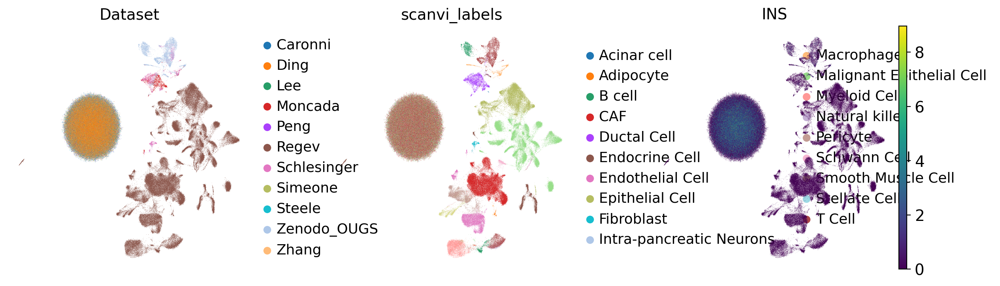

In [29]:
sc.pl.umap(ref, color=['Dataset', 'scanvi_labels', 'INS'])

In [25]:
pwd

'/home/aih/shrey.parikh/PDAC/PDAC/code/notebooks'

In [4]:
scpoli = sc.read_h5ad('../../scPoli/scPoli_donor_reference_latent_label_transfer.h5ad')

In [27]:
scpoli.obs.head()

,Dataset,ID,pseudo_barcode,Level 1 Annotation,Level 2 Annotation,Level 3 Annotation,Cell_type,scanvi_labels,Label_Harmonized,conditions_combined,cell_type_pred,cell_type_uncert,classifier_outcome,batch,Label_Harmonized_pred,Label_Harmonized_uncert,query,scpoli_labels,Condition
GCGTTTCAGCATTTGC-1-0-0,Regev,T25,annotated_cell_1,Endothelial,Vascular,Vascular,NaN,Endothelial Cell,Endothelial Cell,Regev,NaN,NaN,<NA>,NaN,NaN,NaN,0,Endothelial Cell,snRNA-seq
AACAACCAGCTCGCAC-1-0-0,Regev,T25,annotated_cell_2,Epithelial (non-malignant),Ductal (atypical),Ductal (atypical),NaN,Epithelial Cell,Epithelial Cell,Regev,NaN,NaN,<NA>,NaN,NaN,NaN,0,Epithelial Cell,snRNA-seq
ACTGTCCTCTTAAGGC-1-0-0,Regev,T25,annotated_cell_3,Endothelial,Vascular,Vascular,NaN,Endothelial Cell,Endothelial Cell,Regev,NaN,NaN,<NA>,NaN,NaN,NaN,0,Endothelial Cell,snRNA-seq
CTATCCGAGCCTATTG-1-0-0,Regev,T25,annotated_cell_4,Epithelial (malignant),Malignant,Malignant,NaN,Malignant Epithelial Cell,Malignant Epithelial Cell,Regev,NaN,NaN,<NA>,NaN,NaN,NaN,0,Malignant Epithelial Cell,snRNA-seq
GACCTTCTCCGCTGTT-1-0-0,Regev,T25,annotated_cell_5,Cancer-associated fibroblast,myCAF,myCAF,NaN,CAF,CAF,Regev,NaN,NaN,<NA>,NaN,NaN,NaN,0,CAF,snRNA-seq


In [28]:
latent_to_adata_idx = {barcode: idx for idx, barcode in enumerate(adata.obs['pseudo_barcode'])}
ordered_adata_idx = [latent_to_adata_idx[barcode] for barcode in scpoli.obs.pseudo_barcode if barcode in latent_to_adata_idx]
adata = adata[ordered_adata_idx]

In [29]:
adata.obs.head()

,Dataset,ID,pseudo_barcode,scanvi_labels,Label_Harmonized,conditions_combined,cell_type_pred,cell_type_uncert,Label_Harmonized_pred,Label_Harmonized_uncert,...,Cell_type_Schlesinger,Malignant Classification_Schlesinger,cell_types_Ding,Label_Harmonized_Ding,Malignant_Classification_Regev,Malignant_Classification_Ding,Malignant_Classification,Label_Harmonized_Merged,Predicted_Malignant_Classification,Predicted_MC_Probability
GCGTTTCAGCATTTGC-1-0-0,Regev,T25,annotated_cell_1,Endothelial Cell,Endothelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Endothelial Cell,Non-Malignant,0.001688
AACAACCAGCTCGCAC-1-0-0,Regev,T25,annotated_cell_2,Epithelial Cell,Epithelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Epithelial Cell,Non-Malignant,0.006803
ACTGTCCTCTTAAGGC-1-0-0,Regev,T25,annotated_cell_3,Endothelial Cell,Endothelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Endothelial Cell,Non-Malignant,0.006047
CTATCCGAGCCTATTG-1-0-0,Regev,T25,annotated_cell_4,Malignant Epithelial Cell,Malignant Epithelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Malignant,nan,Malignant,Malignant Epithelial Cell,Malignant,0.977772
GACCTTCTCCGCTGTT-1-0-0,Regev,T25,annotated_cell_5,CAF,CAF,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,CAF,Non-Malignant,0.004095


In [6]:
ref.obs.head()

,Dataset,ID,pseudo_barcode,Level 1 Annotation,Level 2 Annotation,Level 3 Annotation,Cell_type,scanvi_labels,Label_Harmonized
AAACCCAAGTCATCGT-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_1,NaN,NaN,NaN,NaN,Myeloid Cell,Unknown
AAACCCACAACCACGC-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_2,NaN,NaN,NaN,NaN,CAF,Unknown
AAACCCACAACTCCCT-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_3,NaN,NaN,NaN,NaN,T Cell,Unknown
AAACCCACAGACAATA-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_4,NaN,NaN,NaN,NaN,T Cell,Unknown
AAACCCACATGCCGAC-1-HT056P-S1PAA1-0-0-0,Ding,HT056P1,non_annotated_cell_5,NaN,NaN,NaN,NaN,T Cell,Unknown


In [5]:
scpoli.obs.head()

,Dataset,ID,pseudo_barcode,Level 1 Annotation,Level 2 Annotation,Level 3 Annotation,Cell_type,scanvi_labels,Label_Harmonized,conditions_combined,cell_type_pred,cell_type_uncert,classifier_outcome,batch,Label_Harmonized_pred,Label_Harmonized_uncert,query,scpoli_labels,Condition
GCGTTTCAGCATTTGC-1-0-0,Regev,T25,annotated_cell_1,Endothelial,Vascular,Vascular,NaN,Endothelial Cell,Endothelial Cell,Regev,NaN,NaN,<NA>,NaN,NaN,NaN,0,Endothelial Cell,snRNA-seq
AACAACCAGCTCGCAC-1-0-0,Regev,T25,annotated_cell_2,Epithelial (non-malignant),Ductal (atypical),Ductal (atypical),NaN,Epithelial Cell,Epithelial Cell,Regev,NaN,NaN,<NA>,NaN,NaN,NaN,0,Epithelial Cell,snRNA-seq
ACTGTCCTCTTAAGGC-1-0-0,Regev,T25,annotated_cell_3,Endothelial,Vascular,Vascular,NaN,Endothelial Cell,Endothelial Cell,Regev,NaN,NaN,<NA>,NaN,NaN,NaN,0,Endothelial Cell,snRNA-seq
CTATCCGAGCCTATTG-1-0-0,Regev,T25,annotated_cell_4,Epithelial (malignant),Malignant,Malignant,NaN,Malignant Epithelial Cell,Malignant Epithelial Cell,Regev,NaN,NaN,<NA>,NaN,NaN,NaN,0,Malignant Epithelial Cell,snRNA-seq
GACCTTCTCCGCTGTT-1-0-0,Regev,T25,annotated_cell_5,Cancer-associated fibroblast,myCAF,myCAF,NaN,CAF,CAF,Regev,NaN,NaN,<NA>,NaN,NaN,NaN,0,CAF,snRNA-seq


In [57]:
scpoli.obs.pseudo_barcode = scpoli.obs.pseudo_barcode.astype(str)
ref.obs.pseudo_barcode = ref.obs.pseudo_barcode.astype(str)

In [16]:
del ordered_adata_idx

In [17]:
latent_to_adata_idx = {barcode: idx for idx, barcode in enumerate(scpoli.obs.pseudo_barcode)}
ordered_adata_idx = [latent_to_adata_idx[barcode] for barcode in ref.obs.pseudo_barcode if barcode in latent_to_adata_idx]
ref = ref[ordered_adata_idx]

In [18]:
ref.obs.head()

,Dataset,ID,pseudo_barcode,Level 1 Annotation,Level 2 Annotation,Level 3 Annotation,Cell_type,scanvi_labels,Label_Harmonized
TACGCTCTCACGGACC-1,Simeone,GSM6204127_P19,non_annotated_cell_342202,NaN,NaN,NaN,NaN,T Cell,Unknown
GTCGTAAGTTACCTTT-1-HT200P1-XBc2_1-1,Ding,HT200P1,non_annotated_cell_143667,NaN,NaN,NaN,NaN,B cell,Unknown
GTCGTAATCTACTTCA-1-HT200P1-XBc2_1-1,Ding,HT200P1,non_annotated_cell_143668,NaN,NaN,NaN,NaN,Malignant Epithelial Cell,Unknown
TTCTCTCGTGAATTAG-1,Caronni,GSM6727550_PDAC,non_annotated_cell_517000,NaN,NaN,NaN,NaN,Pericyte,Unknown
GTCGTTCAGTCTTGGT-1-HT200P1-XBc2_1-1,Ding,HT200P1,non_annotated_cell_143670,NaN,NaN,NaN,NaN,CAF,Unknown


In [7]:
# Create a mapping from the pseudo_barcode to the index for scpoli
scpoli_idx = {barcode: idx for idx, barcode in enumerate(scpoli.obs['pseudo_barcode'])}

# Create a new order for ref based on the pseudo_barcode order in scpoli
ordered_ref_idx = [scpoli_idx.get(barcode, None) for barcode in ref.obs['pseudo_barcode']]

# Filter out None values which indicate barcodes in ref that were not found in scpoli
ordered_ref_idx = [idx for idx in ordered_ref_idx if idx is not None]

# Check if you are not losing too many cells
print(f"Original ref cells: {len(ref)}, New ordered ref cells: {len(ordered_ref_idx)}")

# Reorder ref according to the new index list if the loss is acceptable
ref = ref[ordered_ref_idx]


Original ref cells: 837983, New ordered ref cells: 837983


In [24]:
ref.obs.head()

,Dataset,ID,pseudo_barcode,Level 1 Annotation,Level 2 Annotation,Level 3 Annotation,Cell_type,scanvi_labels,Label_Harmonized
TACGCTCTCACGGACC-1,Simeone,GSM6204127_P19,non_annotated_cell_342202,NaN,NaN,NaN,NaN,T Cell,Unknown
GTCGTAAGTTACCTTT-1-HT200P1-XBc2_1-1,Ding,HT200P1,non_annotated_cell_143667,NaN,NaN,NaN,NaN,B cell,Unknown
GTCGTAATCTACTTCA-1-HT200P1-XBc2_1-1,Ding,HT200P1,non_annotated_cell_143668,NaN,NaN,NaN,NaN,Malignant Epithelial Cell,Unknown
TTCTCTCGTGAATTAG-1,Caronni,GSM6727550_PDAC,non_annotated_cell_517000,NaN,NaN,NaN,NaN,Pericyte,Unknown
GTCGTTCAGTCTTGGT-1-HT200P1-XBc2_1-1,Ding,HT200P1,non_annotated_cell_143670,NaN,NaN,NaN,NaN,CAF,Unknown


In [23]:
scpoli.X

array([[ 0.1692018 ,  0.15096557,  0.28195474, ...,  0.24183223,
         0.0559453 , -0.06880263],
       [ 0.24501997,  0.05078585, -0.06482875, ...,  0.10424168,
        -0.0110417 , -0.09797437],
       [ 0.15324348,  0.09081817,  0.2581287 , ...,  0.25028145,
         0.08569392, -0.07258573],
       ...,
       [ 0.14365761,  0.07692792, -0.11188418, ...,  0.1252842 ,
         0.1432999 , -0.05154156],
       [ 0.17613843,  0.09729387, -0.02592936, ...,  0.11514308,
         0.09330712, -0.11179765],
       [ 0.13766535,  0.0409645 , -0.04659943, ...,  0.12629284,
        -0.04353345, -0.10700123]], dtype=float32)

In [25]:
scpoli

AnnData object with n_obs × n_vars = 838036 × 10
    obs: 'Dataset', 'ID', 'pseudo_barcode', 'Level 1 Annotation', 'Level 2 Annotation', 'Level 3 Annotation', 'Cell_type', 'scanvi_labels', 'Label_Harmonized', 'conditions_combined', 'cell_type_pred', 'cell_type_uncert', 'classifier_outcome', 'batch', 'Label_Harmonized_pred', 'Label_Harmonized_uncert', 'query', 'scpoli_labels', 'Condition'
    uns: 'neighbors', 'umap'
    obsm: 'X_umap'
    obsp: 'connectivities', 'distances'

In [41]:
pwd

'/ictstr01/home/aih/shrey.parikh/PDAC/PDAC/code/notebooks'

In [68]:
test1 = sc.read_h5ad('/home/aih/shrey.parikh/PDAC/PDAC/datasets_metrics/scPoli/scPoli_dataset_reference_latent_label_transfer_metrics.h5ad')

In [66]:
adata = test1

In [67]:
test1.obs.scpoli_labels

pseudo_barcode
annotated_cell_1                      Endothelial Cell
annotated_cell_2                       Epithelial Cell
annotated_cell_3                      Endothelial Cell
annotated_cell_4             Malignant Epithelial Cell
annotated_cell_5                                   CAF
                                       ...            
non_annotated_cell_568545                  Ductal Cell
non_annotated_cell_568546                  Ductal Cell
non_annotated_cell_568547    Malignant Epithelial Cell
non_annotated_cell_568548                  Ductal Cell
non_annotated_cell_568549                  Ductal Cell
Name: scpoli_labels, Length: 837983, dtype: object

In [62]:
adata.obs['scpoli_labels'] = adata.obs.Label_Harmonized.fillna('Unknown')
adata.obs = adata.obs.astype(str)
adata.obs.loc[adata.obs['scpoli_labels'] == 'Unknown', 'scpoli_labels'] = adata.obs.loc[adata.obs['scpoli_labels'] == 'Unknown', 'cell_type_pred']

In [63]:
adata.obs

,Dataset,ID,pseudo_barcode,scanvi_labels,Label_Harmonized,conditions_combined,cell_type_pred,cell_type_uncert,Label_Harmonized_pred,Label_Harmonized_uncert,...,Cell_type_Schlesinger,Malignant Classification_Schlesinger,cell_types_Ding,Label_Harmonized_Ding,Malignant_Classification_Regev,Malignant_Classification_Ding,Malignant_Classification,Label_Harmonized_Merged,Predicted_Malignant_Classification,Predicted_MC_Probability
pseudo_barcode,,,,,,,,,,,,,,,,,,,,,
annotated_cell_1,Regev,T25,annotated_cell_1,Endothelial Cell,Endothelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Endothelial Cell,Non-Malignant,0.0016880671
annotated_cell_2,Regev,T25,annotated_cell_2,Epithelial Cell,Epithelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Epithelial Cell,Non-Malignant,0.0068025687
annotated_cell_3,Regev,T25,annotated_cell_3,Endothelial Cell,Endothelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,Endothelial Cell,Non-Malignant,0.006046751
annotated_cell_4,Regev,T25,annotated_cell_4,Malignant Epithelial Cell,Malignant Epithelial Cell,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Malignant,nan,Malignant,Malignant Epithelial Cell,Malignant,0.97777164
annotated_cell_5,Regev,T25,annotated_cell_5,CAF,CAF,Regev,nan,nan,nan,nan,...,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,CAF,Non-Malignant,0.0040948684
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
non_annotated_cell_568545,Zhang,GSM5910784_Case1-YF_PDAC,non_annotated_cell_568545,Malignant Epithelial Cell,Unknown,Zhang,Ductal Cell,0.32598310708999634,nan,nan,...,nan,nan,nan,nan,nan,nan,Non-Malignant,nan,Non-Malignant,0.44106516
non_annotated_cell_568546,Zhang,GSM5910784_Case1-YF_PDAC,non_annotated_cell_568546,Malignant Epithelial Cell,Unknown,Zhang,Ductal Cell,0.22000081837177277,nan,nan,...,nan,nan,nan,nan,nan,nan,Non-Malignant,nan,Malignant,0.63302654
non_annotated_cell_568547,Zhang,GSM5910784_Case1-YF_PDAC,non_annotated_cell_568547,Malignant Epithelial Cell,Unknown,Zhang,Malignant Epithelial Cell,0.5913703441619873,nan,nan,...,nan,nan,nan,nan,nan,nan,Non-Malignant,nan,Malignant,0.9867083
